This notebook demonstrates our graph network inductive bias with a symbolic model extraction.

# Preamble and data generation

## Make sure to turn on the GPU via Edit-> Notebook settings. 

In [1]:
#Basic pre-reqs:
import numpy as np
import os
import torch
from torch.autograd import Variable
from matplotlib import pyplot as plt
%matplotlib inline

## Download pre-reqs, and then code for simulations and model files:

(Note: installing torch-geometric may take a long time.)

In [2]:
!pip install celluloid

In [3]:
version_nums = torch.__version__.split('.')
# Torch Geometric seems to always build for *.*.0 of torch :
version_nums[-1] = '0' + version_nums[-1][1:]
os.environ['TORCH'] = '.'.join(version_nums)
 
#!pip install --upgrade torch-scatter -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-sparse -f https://pytorch-geometric.com/whl/torch-${TORCH}.html && pip install --upgrade torch-geometric

In [4]:
!wget https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/models.py -O models.py
!wget https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/simulate.py -O simulate.py

--2023-11-16 06:07:30--  https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/models.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8001::154, 2606:50c0:8003::154, 2606:50c0:8002::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8001::154|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9647 (9.4K) [text/plain]
Saving to: ‘models.py’

models.py           100%[===================>]   9.42K  --.-KB/s    in 0.002s  

2023-11-16 06:07:31 (3.79 MB/s) - ‘models.py’ saved [9647/9647]

--2023-11-16 06:07:31--  https://raw.githubusercontent.com/MilesCranmer/symbolic_deep_learning/master/simulate.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8002::154, 2606:50c0:8000::154, 2606:50c0:8001::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8002::154|:443... connected.
HTTP request sent, awaiting response... 20

In [5]:
import models
import simulate

## Assert we have a GPU:

In [6]:
#torch.ones(1).cuda()

In [7]:
import torch

if torch.cuda.is_available():
    print("CUDA is available. You can use GPU acceleration.")
else:
    print("CUDA is not available. Check your installation.")

CUDA is not available. Check your installation.


## Create the simulation:

In [8]:
# Number of simulations to run (it's fast, don't worry):
ns = 10000
# Potential (see below for options)
sim = 'spring'
# Number of nodes
n = 4 #OAC: I changed this from 4 to 8 based on the end of Appendix B
# Dimension
dim = 2
# Number of time steps
nt = 1000


#Standard simulation sets:
n_set = [4, 8]
sim_sets = [
 {'sim': 'r1', 'dt': [5e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'r2', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'spring', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'string', 'dt': [1e-2], 'nt': [1000], 'n': [30], 'dim': [2]},
 {'sim': 'charge', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'superposition', 'dt': [1e-3], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'damped', 'dt': [2e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
 {'sim': 'discontinuous', 'dt': [1e-2], 'nt': [1000], 'n': n_set, 'dim': [2, 3]},
]


#Select the hand-tuned dt value for a smooth simulation
# (since scales are different in each potential):
dt = [ss['dt'][0] for ss in sim_sets if ss['sim'] == sim][0]

title = '{}_n={}_dim={}_nt={}_dt={}'.format(sim, n, dim, nt, dt)
print('Running on', title)

Running on spring_n=4_dim=2_nt=1000_dt=0.01


## Generate simulation data:

In [9]:
from simulate import SimulationDataset
s = SimulationDataset(sim, n=n, dim=dim, nt=nt//2, dt=dt)
# Update this to your own dataset, or regenerate:
base_str = './'
data_str = title
s.simulate(ns)

In [10]:
data = s.data
s.data.shape

(10000, 500, 4, 6)

### Let's visualize an example simulation:

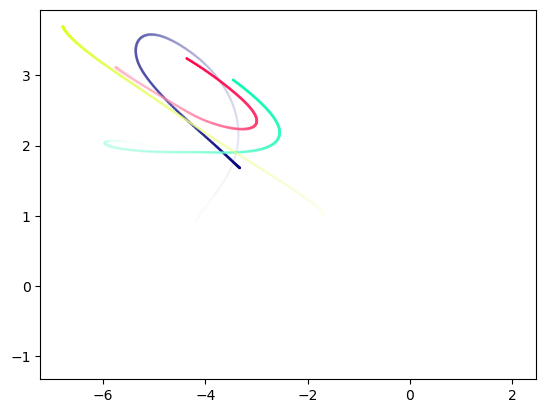

In [11]:
s.plot(0, animate=True, plot_size=False)

## We'll train on the accelerations, so let's generate the dataset:

In [12]:
accel_data = s.get_acceleration()

In [13]:
X = torch.from_numpy(np.concatenate([s.data[:, i] for i in range(0, s.data.shape[1], 5)]))
y = torch.from_numpy(np.concatenate([accel_data[:, i] for i in range(0, s.data.shape[1], 5)]))

In [14]:
from sklearn.model_selection import train_test_split

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False)

# Set up the model

In [16]:
import torch
from torch import nn
from torch.functional import F
from torch.optim import Adam
from torch_geometric.nn import MetaLayer, MessagePassing

In [17]:
from models import OGN, varOGN, make_packer, make_unpacker, get_edge_index

## Use the L1 regularization model:

In [18]:
aggr = 'add'
hidden = 300

test = '_l1_'

#This test applies an explicit bottleneck:

msg_dim = 100
n_f = data.shape[3]

L1 loss: we simply add the loss to the batch number. I.e., * 32 for batch size 32.

KL loss: model the messages as a distribution with the prior a Gaussian. The means add in the final Gaussian. 
Recall in the D_KL(p||q), the prior is q.  Then, for sigma_q = 1, mu_q = 0, we have ($p=1$):

$$D_{KL}(p||q) = \frac{\sigma_p^2 + \mu_p^2}{2} -\log({\sigma_p}) - \frac{1}{2}$$

## We use a custom data loader for the graphs for fast training:

In [19]:
from torch_geometric.data import Data, DataLoader

In [20]:
from models import get_edge_index

In [21]:
edge_index = get_edge_index(n, sim)

## Initiate the model:

In [22]:
if test == '_kl_':
    ogn = varOGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr) #.cuda()
else:
    ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr) #.cuda()

messages_over_time = []
#ogn = ogn.cuda()
ogn

OGN()

### Let's test it:

In [23]:
_q = Data(
    x=X_train[0], #.cuda(),
    edge_index =edge_index, #.cuda(),
    y=y_train[0]) #.cuda())
ogn(_q.x, _q.edge_index), ogn.just_derivative(_q).shape, _q.y.shape, ogn.loss(_q), 

(tensor([[-0.0044, -0.0552],
         [-0.0065, -0.0656],
         [-0.0140, -0.0692],
         [-0.0092, -0.0679]], grad_fn=<AddmmBackward0>),
 torch.Size([4, 2]),
 torch.Size([4, 2]),
 tensor(24.6924, grad_fn=<SumBackward0>))

# Set up training

## Organize into data loader:

In [24]:
batch = int(64 * (4 / n)**2)
trainloader = DataLoader(
    [Data(
        Variable(X_train[i]),
        edge_index=edge_index,
        y=Variable(y_train[i])) for i in range(len(y_train))],
    batch_size=batch,
    shuffle=True
)

testloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in range(len(y_test))],
    batch_size=1024,
    shuffle=True
)

/home/omar/anaconda3/envs/nbody_env/lib/python3.8/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


## We'll use OneCycleLR for fast training:

In [25]:
from torch.optim.lr_scheduler import ReduceLROnPlateau, OneCycleLR

## Create the loss function

This holds definition of our L1 and KL regularizations:

In [26]:
def new_loss(self, g, augment=True, square=False):
    if square:
        return torch.sum((g.y - self.just_derivative(g, augment=augment))**2)
    else:
        base_loss = torch.sum(torch.abs(g.y - self.just_derivative(g, augment=augment)))
        if test in ['_l1_', '_kl_']:
            s1 = g.x[self.edge_index[0]]
            s2 = g.x[self.edge_index[1]]
            if test == '_l1_':
                m12 = self.message(s1, s2)
                regularization = 1e-2
                #Want one loss value per row of g.y:
                normalized_l05 = torch.sum(torch.abs(m12))
                return base_loss, regularization * batch * normalized_l05 / n**2 * n
            elif test == '_kl_':
                regularization = 1
                #Want one loss value per row of g.y:
                tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
                raw_msg = self.msg_fnc(tmp)
                mu = raw_msg[:, 0::2]
                logvar = raw_msg[:, 1::2]
                full_kl = torch.sum(torch.exp(logvar) + mu**2 - logvar)/2.0
                return base_loss, regularization * batch * full_kl / n**2 * n
        return base_loss

## Set up optimizer and training parameters:

**Use 200 epochs for full version; can use fewer for test.**

In [27]:
init_lr = 1e-3

opt = torch.optim.Adam(ogn.parameters(), lr=init_lr, weight_decay=1e-8)

total_epochs = 200
# total_epochs = 30


batch_per_epoch = int(1000*10 / (batch/32.0))

sched = OneCycleLR(opt, max_lr=init_lr,
                   steps_per_epoch=batch_per_epoch,#len(trainloader),
                   epochs=total_epochs, final_div_factor=1e5)

batch_per_epoch

5000

In [28]:
epoch = 0

In [29]:
from tqdm import tqdm

## Organize the recording of messages over time

This is for fitting the forces, and extracting laws:

In [30]:
import numpy as onp
onp.random.seed(0)
test_idxes = onp.random.randint(0, len(X_test), 1000)

#Record messages over test dataset here:
newtestloader = DataLoader(
    [Data(
        X_test[i],
        edge_index=edge_index,
        y=y_test[i]) for i in test_idxes],
    batch_size=len(X_test),
    shuffle=False
)

### Function to record messages from model

In [31]:
import numpy as onp
import pandas as pd

def get_messages(ogn):

    def get_message_info(tmp):
        ogn.cpu()

        s1 = tmp.x[tmp.edge_index[0]]
        s2 = tmp.x[tmp.edge_index[1]]
        tmp = torch.cat([s1, s2], dim=1)  # tmp has shape [E, 2 * in_channels]
        if test == '_kl_':
            raw_msg = ogn.msg_fnc(tmp)
            mu = raw_msg[:, 0::2]
            logvar = raw_msg[:, 1::2]

            m12 = mu
        else:
            m12 = ogn.msg_fnc(tmp)

        all_messages = torch.cat((
            s1,
            s2,
            m12), dim=1)
        if dim == 2:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d vx%d vy%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]
        elif dim == 3:
            columns = [elem%(k) for k in range(1, 3) for elem in 'x%d y%d z%d vx%d vy%d vz%d q%d m%d'.split(' ')]
            columns += ['e%d'%(k,) for k in range(msg_dim)]


        return pd.DataFrame(
            data=all_messages.cpu().detach().numpy(),
            columns=columns
        )

    msg_info = []
    for i, g in enumerate(newtestloader):
        msg_info.append(get_message_info(g))

    msg_info = pd.concat(msg_info)
    msg_info['dx'] = msg_info.x1 - msg_info.x2
    msg_info['dy'] = msg_info.y1 - msg_info.y2
    if dim == 2:
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2
        )
    elif dim == 3:
        msg_info['dz'] = msg_info.z1 - msg_info.z2
        msg_info['r'] = np.sqrt(
            (msg_info.dx)**2 + (msg_info.dy)**2 + (msg_info.dz)**2
        )
    
    return msg_info

In [32]:
recorded_models = []

# Train the model:

## Training loop:

In [33]:
for epoch in tqdm(range(epoch, total_epochs)):
    ogn #.cuda()
    total_loss = 0.0
    i = 0
    num_items = 0
    while i < batch_per_epoch:
        for ginput in trainloader:
            if i >= batch_per_epoch:
                break
            opt.zero_grad()
            ginput.x = ginput.x #.cuda()
            ginput.y = ginput.y #.cuda()
            ginput.edge_index = ginput.edge_index # .cuda()
            ginput.batch = ginput.batch #.cuda()
            if test in ['_l1_', '_kl_']:
                loss, reg = new_loss(ogn, ginput, square=False)
                ((loss + reg)/int(ginput.batch[-1]+1)).backward()
            else:
                loss = ogn.loss(ginput, square=False)
                (loss/int(ginput.batch[-1]+1)).backward()
            opt.step()
            sched.step()

            total_loss += loss.item()
            i += 1
            num_items += int(ginput.batch[-1]+1)

    cur_loss = total_loss/num_items
    print(cur_loss)
    cur_msgs = get_messages(ogn)
    cur_msgs['epoch'] = epoch
    cur_msgs['loss'] = cur_loss
    messages_over_time.append(cur_msgs)
    
    ogn.cpu()
    from copy import deepcopy as copy
    recorded_models.append(ogn.state_dict())

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 1/200 [02:22<7:51:01, 142.02s/it]

12.496477415847778


  1%|          | 2/200 [03:29<5:23:45, 98.11s/it] 

8.552541426372528


  2%|▏         | 3/200 [04:37<4:37:50, 84.62s/it]

6.685342965698243


  2%|▏         | 4/200 [05:41<4:08:51, 76.18s/it]

5.256189735555648


  2%|▎         | 5/200 [06:45<3:53:36, 71.88s/it]

4.579522073698044


  3%|▎         | 6/200 [07:49<3:43:36, 69.16s/it]

4.1580480782985685


  4%|▎         | 7/200 [08:54<3:37:50, 67.72s/it]

3.9309533421754836


  4%|▍         | 8/200 [09:57<3:31:53, 66.22s/it]

3.7389775968551637


  4%|▍         | 9/200 [10:59<3:26:36, 64.90s/it]

3.6196729886770247


  5%|▌         | 10/200 [12:04<3:25:32, 64.91s/it]

3.534301256227493


  6%|▌         | 11/200 [13:07<3:23:30, 64.60s/it]

3.3614962070703505


  6%|▌         | 12/200 [14:16<3:26:14, 65.82s/it]

3.223679531955719


  6%|▋         | 13/200 [15:23<3:25:57, 66.08s/it]

3.0871208449363707


  7%|▋         | 14/200 [16:26<3:22:31, 65.33s/it]

2.966850354337692


  8%|▊         | 15/200 [17:32<3:21:38, 65.40s/it]

2.7553218710660934


  8%|▊         | 16/200 [18:42<3:24:33, 66.70s/it]

2.561192143344879


  8%|▊         | 17/200 [19:52<3:26:36, 67.74s/it]

2.346200399518013


  9%|▉         | 18/200 [20:58<3:24:23, 67.38s/it]

2.138501071691513


 10%|▉         | 19/200 [22:04<3:21:28, 66.79s/it]

1.9143177179694175


 10%|█         | 20/200 [23:10<3:19:37, 66.54s/it]

1.8506508677959441


 10%|█         | 21/200 [24:24<3:25:10, 68.78s/it]

1.7059544020533561


 11%|█         | 22/200 [25:31<3:23:09, 68.48s/it]

1.6011720198154449


 12%|█▏        | 23/200 [26:36<3:18:18, 67.23s/it]

1.5690972522020339


 12%|█▏        | 24/200 [27:45<3:19:02, 67.86s/it]

1.4695164315462113


 12%|█▎        | 25/200 [28:58<3:22:30, 69.43s/it]

1.402869817698002


 13%|█▎        | 26/200 [30:12<3:25:03, 70.71s/it]

1.4138408294081688


 14%|█▎        | 27/200 [31:27<3:27:54, 72.11s/it]

1.3711305377364158


 14%|█▍        | 28/200 [32:43<3:29:51, 73.20s/it]

1.3634982521057128


 14%|█▍        | 29/200 [34:03<3:34:21, 75.21s/it]

1.37071063529253


 15%|█▌        | 30/200 [35:24<3:38:18, 77.05s/it]

1.3356364843010902


 16%|█▌        | 31/200 [36:51<3:45:10, 79.94s/it]

1.35275698171854


 16%|█▌        | 32/200 [38:19<3:50:20, 82.26s/it]

1.3829698009490967


 16%|█▋        | 33/200 [39:49<3:55:46, 84.71s/it]

1.3806966342449187


 17%|█▋        | 34/200 [41:22<4:01:35, 87.32s/it]

1.3768253244638442


 18%|█▊        | 35/200 [42:55<4:04:44, 89.00s/it]

1.376695216691494


 18%|█▊        | 36/200 [44:32<4:09:30, 91.28s/it]

1.3854369576931


 18%|█▊        | 37/200 [46:12<4:15:03, 93.89s/it]

1.339057950758934


 19%|█▉        | 38/200 [47:57<4:22:20, 97.17s/it]

1.3829474457919597


 20%|█▉        | 39/200 [49:43<4:28:18, 99.99s/it]

1.3506573806583881


 20%|██        | 40/200 [51:32<4:33:34, 102.59s/it]

1.3217623142719268


 20%|██        | 41/200 [53:24<4:39:22, 105.43s/it]

1.3388829692840576


 21%|██        | 42/200 [55:21<4:47:07, 109.04s/it]

1.3451322634220124


 22%|██▏       | 43/200 [57:31<5:01:40, 115.29s/it]

1.2991594675898552


 22%|██▏       | 44/200 [59:47<5:15:55, 121.51s/it]

1.3582655008554458


 22%|██▎       | 45/200 [1:02:13<5:32:26, 128.69s/it]

1.318910861223936


 23%|██▎       | 46/200 [1:04:44<5:47:27, 135.37s/it]

1.321033936560154


 24%|██▎       | 47/200 [1:07:50<6:24:21, 150.73s/it]

1.325218226504326


 24%|██▍       | 48/200 [1:11:10<6:59:09, 165.45s/it]

1.3046746437072754


 24%|██▍       | 49/200 [1:14:24<7:18:00, 174.04s/it]

1.3250979759693147


 25%|██▌       | 50/200 [1:17:25<7:20:16, 176.11s/it]

1.2675690281867982


 26%|██▌       | 51/200 [1:20:38<7:29:42, 181.09s/it]

1.3265361493706702


 26%|██▌       | 52/200 [1:23:54<7:37:31, 185.48s/it]

1.2899532155573368


 26%|██▋       | 53/200 [1:27:26<7:53:56, 193.45s/it]

1.2843287445485592


 27%|██▋       | 54/200 [1:31:06<8:10:04, 201.40s/it]

1.2736640453875065


 28%|██▊       | 55/200 [1:34:48<8:22:11, 207.80s/it]

1.275392051386833


 28%|██▊       | 56/200 [1:38:17<8:19:10, 207.99s/it]

1.2598124722719193


 28%|██▊       | 57/200 [1:41:48<8:18:17, 209.07s/it]

1.2334780545949935


 29%|██▉       | 58/200 [1:45:20<8:16:29, 209.78s/it]

1.2116096219837666


 30%|██▉       | 59/200 [1:48:55<8:16:26, 211.25s/it]

1.220104009640217


 30%|███       | 60/200 [1:52:37<8:20:29, 214.49s/it]

1.2067087207973004


 30%|███       | 61/200 [1:56:20<8:23:08, 217.18s/it]

1.1748774052023887


 31%|███       | 62/200 [2:00:09<8:27:35, 220.69s/it]

1.1609984607934951


 32%|███▏      | 63/200 [2:04:13<8:40:09, 227.81s/it]

1.1528082063138485


 32%|███▏      | 64/200 [2:08:14<8:44:51, 231.55s/it]

1.1323056757688523


 32%|███▎      | 65/200 [2:12:33<8:59:34, 239.81s/it]

1.122968745982647


 33%|███▎      | 66/200 [2:16:41<9:01:17, 242.37s/it]

1.130893604964018


 34%|███▎      | 67/200 [2:20:50<9:01:47, 244.42s/it]

1.1103891421496868


 34%|███▍      | 68/200 [2:25:05<9:04:23, 247.45s/it]

1.1055866362512112


 34%|███▍      | 69/200 [2:29:14<9:01:24, 247.97s/it]

1.079065893626213


 35%|███▌      | 70/200 [2:33:29<9:01:33, 249.95s/it]

1.0588188691020013


 36%|███▌      | 71/200 [2:37:40<8:58:37, 250.52s/it]

1.0657522122621537


 36%|███▌      | 72/200 [2:41:41<8:47:52, 247.44s/it]

1.0548501572608948


 36%|███▋      | 73/200 [2:45:44<8:41:26, 246.35s/it]

1.0435901933073997


 37%|███▋      | 74/200 [2:49:55<8:39:48, 247.53s/it]

1.0451907591223717


 38%|███▊      | 75/200 [2:54:09<8:40:08, 249.67s/it]

0.9998602268576622


 38%|███▊      | 76/200 [2:58:26<8:40:13, 251.72s/it]

0.9989525122225285


 38%|███▊      | 77/200 [3:02:44<8:39:56, 253.63s/it]

0.9844561814069748


 39%|███▉      | 78/200 [3:07:04<8:39:53, 255.68s/it]

1.001173196154833


 40%|███▉      | 79/200 [3:11:27<8:39:40, 257.69s/it]

0.9701255366265774


 40%|████      | 80/200 [3:15:51<8:39:03, 259.53s/it]

0.9681981996834278


 40%|████      | 81/200 [3:20:16<8:38:10, 261.27s/it]

0.9501143140673637


 41%|████      | 82/200 [3:24:46<8:38:47, 263.79s/it]

0.924974866271019


 42%|████▏     | 83/200 [3:29:18<8:39:24, 266.37s/it]

0.9310546700716019


 42%|████▏     | 84/200 [3:33:49<8:37:54, 267.88s/it]

0.9095267829537391


 42%|████▎     | 85/200 [3:38:21<8:35:19, 268.87s/it]

0.8988171435892582


 43%|████▎     | 86/200 [3:42:55<8:34:04, 270.56s/it]

0.9130018720805645


 44%|████▎     | 87/200 [3:47:29<8:31:25, 271.55s/it]

0.8927067606210709


 44%|████▍     | 88/200 [3:52:07<8:30:43, 273.60s/it]

0.8752905483305454


 44%|████▍     | 89/200 [3:56:45<8:28:26, 274.83s/it]

0.860673803126812


 45%|████▌     | 90/200 [4:01:27<8:27:30, 276.82s/it]

0.878939258569479


 46%|████▌     | 91/200 [4:06:08<8:25:23, 278.20s/it]

0.8512435805261135


 46%|████▌     | 92/200 [4:10:50<8:23:01, 279.46s/it]

0.843338010430336


 46%|████▋     | 93/200 [4:15:35<8:21:00, 280.94s/it]

0.8251625859916211


 47%|████▋     | 94/200 [4:20:21<8:19:13, 282.58s/it]

0.8212689696133136


 48%|████▊     | 95/200 [4:25:12<8:18:41, 284.96s/it]

0.8053315404772758


 48%|████▊     | 96/200 [4:30:16<8:23:55, 290.73s/it]

0.7896045817136764


 48%|████▊     | 97/200 [4:36:01<8:47:19, 307.18s/it]

0.7878044627785683


 49%|████▉     | 98/200 [4:41:48<9:02:27, 319.09s/it]

0.7798115569472313


 50%|████▉     | 99/200 [4:47:16<9:01:22, 321.61s/it]

0.7781040658175945


 50%|█████     | 100/200 [4:52:46<9:00:08, 324.09s/it]

0.7474468005299568


 50%|█████     | 101/200 [4:58:11<8:55:16, 324.41s/it]

0.7546865286707878


 51%|█████     | 102/200 [5:03:32<8:48:20, 323.48s/it]

0.7391691303253174


 52%|█████▏    | 103/200 [5:08:57<8:43:40, 323.92s/it]

0.7367269890785217


 52%|█████▏    | 104/200 [5:14:06<8:30:51, 319.29s/it]

0.7149906524956227


 52%|█████▎    | 105/200 [5:19:10<8:18:38, 314.93s/it]

0.7079626572728157


 53%|█████▎    | 106/200 [5:24:17<8:09:18, 312.32s/it]

0.7110499926805496


 54%|█████▎    | 107/200 [5:29:22<8:00:53, 310.25s/it]

0.6988294888615608


 54%|█████▍    | 108/200 [5:34:27<7:53:21, 308.71s/it]

0.6955816629469395


 55%|█████▍    | 109/200 [5:39:36<7:48:21, 308.81s/it]

0.6914029992580414


 55%|█████▌    | 110/200 [5:44:55<7:47:32, 311.70s/it]

0.6808488363265991


 56%|█████▌    | 111/200 [5:49:56<7:37:39, 308.54s/it]

0.6730163277029991


 56%|█████▌    | 112/200 [5:54:55<7:28:35, 305.86s/it]

0.6568806645870209


 56%|█████▋    | 113/200 [5:59:56<7:21:20, 304.37s/it]

0.6420647547364234


 57%|█████▋    | 114/200 [6:04:58<7:15:02, 303.52s/it]

0.6245678179144859


 57%|█████▊    | 115/200 [6:09:59<7:09:06, 302.90s/it]

0.6326033965468406


 58%|█████▊    | 116/200 [6:15:10<7:07:16, 305.20s/it]

0.598247077035904


 58%|█████▊    | 117/200 [6:20:10<7:00:01, 303.64s/it]

0.6066975328147411


 59%|█████▉    | 118/200 [6:25:11<6:53:47, 302.77s/it]

0.6068993718504906


 60%|█████▉    | 119/200 [6:30:11<6:47:50, 302.10s/it]

0.5859267029255628


 60%|██████    | 120/200 [6:35:41<6:53:59, 310.49s/it]

0.599234719645977


 60%|██████    | 121/200 [6:41:09<6:55:31, 315.59s/it]

0.5633395152032376


 61%|██████    | 122/200 [6:46:07<6:43:33, 310.43s/it]

0.5516584490954876


 62%|██████▏   | 123/200 [6:51:20<6:39:15, 311.11s/it]

0.5522660977065563


 62%|██████▏   | 124/200 [6:56:53<6:42:35, 317.84s/it]

0.5479744046151638


 62%|██████▎   | 125/200 [7:01:57<6:31:54, 313.52s/it]

0.5359406825453042


 63%|██████▎   | 126/200 [7:07:00<6:22:52, 310.43s/it]

0.5340537682771683


 64%|██████▎   | 127/200 [7:12:06<6:16:03, 309.09s/it]

0.5259936048924923


 64%|██████▍   | 128/200 [7:17:14<6:10:26, 308.70s/it]

0.5085304908216


 64%|██████▍   | 129/200 [7:22:22<6:05:02, 308.48s/it]

0.49803929425776006


 65%|██████▌   | 130/200 [7:27:30<5:59:52, 308.47s/it]

0.48455142689049246


 66%|██████▌   | 131/200 [7:32:35<5:53:35, 307.48s/it]

0.48876955994963645


 66%|██████▌   | 132/200 [7:37:39<5:47:11, 306.35s/it]

0.4731468543589115


 66%|██████▋   | 133/200 [7:43:05<5:48:50, 312.40s/it]

0.4643770043581724


 67%|██████▋   | 134/200 [7:48:27<5:46:38, 315.13s/it]

0.4515584619522095


 68%|██████▊   | 135/200 [7:53:51<5:44:15, 317.77s/it]

0.44491707840263844


 68%|██████▊   | 136/200 [7:59:22<5:43:18, 321.85s/it]

0.43698646288514137


 68%|██████▊   | 137/200 [8:04:31<5:33:44, 317.84s/it]

0.4358803341537714


 69%|██████▉   | 138/200 [8:09:56<5:30:47, 320.13s/it]

0.425901404184103


 70%|██████▉   | 139/200 [8:15:05<5:22:06, 316.83s/it]

0.4211167053937912


 70%|███████   | 140/200 [8:20:09<5:12:56, 312.95s/it]

0.40985214110910895


 70%|███████   | 141/200 [8:25:15<5:05:39, 310.85s/it]

0.40092497726380827


 71%|███████   | 142/200 [8:30:21<4:59:01, 309.33s/it]

0.40044368983507156


 72%|███████▏  | 143/200 [8:35:29<4:53:29, 308.93s/it]

0.3861308953881264


 72%|███████▏  | 144/200 [8:40:51<4:52:04, 312.93s/it]

0.3816502403795719


 72%|███████▎  | 145/200 [8:46:26<4:52:51, 319.48s/it]

0.3755701840400696


 73%|███████▎  | 146/200 [8:51:56<4:50:21, 322.62s/it]

0.37006770444512366


 74%|███████▎  | 147/200 [8:57:24<4:46:31, 324.37s/it]

0.3564344835281372


 74%|███████▍  | 148/200 [9:03:01<4:44:22, 328.13s/it]

0.34999545207619664


 74%|███████▍  | 149/200 [9:08:17<4:35:36, 324.25s/it]

0.34530481223762033


 75%|███████▌  | 150/200 [9:13:44<4:31:00, 325.20s/it]

0.34035983487665655


 76%|███████▌  | 151/200 [9:19:05<4:24:40, 324.09s/it]

0.32797661123275756


 76%|███████▌  | 152/200 [9:24:36<4:20:44, 325.92s/it]

0.3261979579985142


 76%|███████▋  | 153/200 [9:30:04<4:15:50, 326.60s/it]

0.3279643855631352


 77%|███████▋  | 154/200 [9:35:58<4:16:48, 334.96s/it]

0.31649116623997686


 78%|███████▊  | 155/200 [9:41:47<4:14:25, 339.23s/it]

0.3122236947864294


 78%|███████▊  | 156/200 [9:47:38<4:11:17, 342.68s/it]

0.30440818428397176


 78%|███████▊  | 157/200 [9:53:28<4:07:01, 344.68s/it]

0.2987831005394459


 79%|███████▉  | 158/200 [9:59:21<4:03:10, 347.40s/it]

0.29440600151121615


 80%|███████▉  | 159/200 [10:05:10<3:57:35, 347.70s/it]

0.29155985315442084


 80%|████████  | 160/200 [10:10:54<3:51:08, 346.71s/it]

0.2847875450491905


 80%|████████  | 161/200 [10:16:40<3:45:08, 346.37s/it]

0.27592041094601155


 81%|████████  | 162/200 [10:22:23<3:38:52, 345.59s/it]

0.27747523539066316


 82%|████████▏ | 163/200 [10:28:02<3:31:44, 343.38s/it]

0.26756233521699907


 82%|████████▏ | 164/200 [10:33:23<3:22:05, 336.83s/it]

0.26685729935467245


 82%|████████▎ | 165/200 [10:38:46<3:13:59, 332.55s/it]

0.2615942705094814


 83%|████████▎ | 166/200 [10:44:07<3:06:30, 329.12s/it]

0.25561369707882403


 84%|████████▎ | 167/200 [10:49:15<2:57:32, 322.81s/it]

0.255637012809515


 84%|████████▍ | 168/200 [10:54:23<2:49:47, 318.35s/it]

0.2502387179642916


 84%|████████▍ | 169/200 [10:59:29<2:42:38, 314.78s/it]

0.2460242242962122


 85%|████████▌ | 170/200 [11:04:38<2:36:24, 312.82s/it]

0.24246574464440346


 86%|████████▌ | 171/200 [11:09:56<2:31:58, 314.43s/it]

0.23828957091867925


 86%|████████▌ | 172/200 [11:15:19<2:27:58, 317.07s/it]

0.23569194849431516


 86%|████████▋ | 173/200 [11:20:26<2:21:22, 314.16s/it]

0.23348992982804775


 87%|████████▋ | 174/200 [11:25:45<2:16:41, 315.42s/it]

0.23113255710601807


 88%|████████▊ | 175/200 [11:30:54<2:10:41, 313.65s/it]

0.22628934499621392


 88%|████████▊ | 176/200 [11:36:02<2:04:43, 311.83s/it]

0.22504304192066193


 88%|████████▊ | 177/200 [11:41:40<2:02:30, 319.59s/it]

0.22347588774561883


 89%|████████▉ | 178/200 [11:46:39<1:54:57, 313.50s/it]

0.22035610812604428


 90%|████████▉ | 179/200 [11:51:40<1:48:25, 309.80s/it]

0.21673892466127873


 90%|█████████ | 180/200 [11:56:41<1:42:24, 307.23s/it]

0.21603277657926082


 90%|█████████ | 181/200 [12:01:43<1:36:48, 305.72s/it]

0.21445165763199328


 91%|█████████ | 182/200 [12:06:43<1:31:11, 303.95s/it]

0.21269639908075333


 92%|█████████▏| 183/200 [12:11:42<1:25:41, 302.46s/it]

0.21030385013818742


 92%|█████████▏| 184/200 [12:16:41<1:20:20, 301.26s/it]

0.208640620470047


 92%|█████████▎| 185/200 [12:21:40<1:15:09, 300.61s/it]

0.20684690246284007


 93%|█████████▎| 186/200 [12:26:39<1:10:01, 300.12s/it]

0.20630911346077918


 94%|█████████▎| 187/200 [12:31:37<1:04:52, 299.40s/it]

0.20486223298311235


 94%|█████████▍| 188/200 [12:36:33<59:41, 298.49s/it]  

0.2034601307719946


 94%|█████████▍| 189/200 [12:41:30<54:38, 298.06s/it]

0.20238309260904788


 95%|█████████▌| 190/200 [12:46:27<49:36, 297.68s/it]

0.20177265342473985


 96%|█████████▌| 191/200 [12:51:23<44:34, 297.18s/it]

0.200736558252573


 96%|█████████▌| 192/200 [12:56:17<39:30, 296.28s/it]

0.200339975258708


 96%|█████████▋| 193/200 [13:01:12<34:32, 296.06s/it]

0.19894052059054373


 97%|█████████▋| 194/200 [13:06:07<29:33, 295.58s/it]

0.19817513933479786


 98%|█████████▊| 195/200 [13:11:01<24:35, 295.18s/it]

0.19841075105071068


 98%|█████████▊| 196/200 [13:15:55<19:38, 294.70s/it]

0.1978656298160553


 98%|█████████▊| 197/200 [13:20:49<14:43, 294.51s/it]

0.1977839469641447


 99%|█████████▉| 198/200 [13:25:44<09:49, 294.60s/it]

0.1974685029834509


100%|█████████▉| 199/200 [13:30:37<04:54, 294.12s/it]

0.19643933058977128


100%|██████████| 200/200 [13:35:30<00:00, 244.65s/it]

0.19653662409484388


Normally you should run all the way to 200 epochs (set this as a parameter so that OneCycleLR is set correctly). This loop was cut off early to quickly test this notebook.

## Save and Load models here to prevent re-training:

In [34]:
import pickle as pkl
pkl.dump(messages_over_time,
    open('messages_over_time.pkl', 'wb'))
messages_over_time = pkl.load(open('messages_over_time.pkl', 'rb'))

In [35]:
pkl.dump(recorded_models,
    open('models_over_time.pkl', 'wb'))

recorded_models = pkl.load(open('models_over_time.pkl', 'rb'))

# Analyze trained model:

## Plot a comparison of the force components with the messages:

### (Or plot the rotation or sparsity - turn these on and off with flags:)

In [36]:
from celluloid import Camera
from copy import deepcopy as copy

Options include:

- plot_force_components: the scatter plots of true force versus message
- plot_sparsity: the grayscale animation of the message components over time
- plot_rotation: plot the vectors showing how the messages are rotations of the true vectors

spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2711474722403067
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2925602326569734


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.283077550817419
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.27512979012948496


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2777698092990451
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2690295636212384


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.2595467574508102
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.24278732864945024


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.22810414632161458
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.21374124032479744


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.196290616635923
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.18952701144748263


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.10533489086009838
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.1005596923828125


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.09551663716634115
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.05421594125253182


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.045785593103479454
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03977775291160301


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.03448461320665147
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02918110882794415


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.024452537254050923
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.017465812541820384


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01583189010620117
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.009631587840892651


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.008416983639752424
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0077302402920193134


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.006279358334011502
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.014214537232010452


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.015130001703898112
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0056753612447668


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.015530876583523222
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.015086950372766564


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.017797718754521123
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01863369659141258


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.019094337887234157
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01997865747522425


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.020535753391407154


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02208676161589446
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.017766395498205113


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01965441986366554
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.020895580009177878


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01989286493372034
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.019057442700421368


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018366834146005137
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.019203385247124567


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02130572001139323
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0207556731612594


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02215108942102503
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.02045061323377821


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.024632589905350295
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.019592343436347113


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018037889268663194
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018364019570527253


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01698898951212565
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016510058685585305


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01685464329189724
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.016473561569496437


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.018743071202878596


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.01851494718480993
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0023857754248159902


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002582119305928548
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002023030475333885


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0016556333612512658
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0014574435463658084


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017790774945859555
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001499861787866663


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001428406547617029
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001289674131958573


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0013561974189899584
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001325539262206466


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001141407467700817
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0009317561432167336


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0010064444718537505
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0008704533179601033


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0008133409641407155
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0009401393598980373


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0006820035422289814
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0006179906262291803


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005498181559421398
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00045232752958933515


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00057658350026166
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0004745393991470337


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005014933921672679
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005311768143265336


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0004136727032838044
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0004963862564828661


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005089872633969342
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00039621379640367296


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0004427619443999396
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00047045687834421795
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005103588545763934


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0008146586241545499
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005411439692532574


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0006413479425289013
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0005310743384891087


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0006302668871702971
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0007551444349465547


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0008511756084583424


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0011911050037101464


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0011195986911102579


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0011815852147561532
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0012345499904067427


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0013851178796203047
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0015060382198404383


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001561200166190112


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017379248087052946


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001849108537038167


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017768455655486496


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002202437972580945


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020235966201181763


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0024556360642115273


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0022174058854579925


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002384047993907222


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002246303734955964


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002558687726656596
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002562122587804441


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028337264502490004


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002407718057985659
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028261460860570273


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002773948422184697
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002933250036504533


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028937336912861576


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002708252905695527
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002871829337543911


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0029780657313488146


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0029260476540636134
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.003003798215477555
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028595580767702172


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0027418075225971363
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028492484710834643


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0028843116373927506
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002566061615943909


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0027709357054145245
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0026474526634922735


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002605993858090153


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0026259221246948948


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0026315174996852874
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002539746573677769


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002468528913127051
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002524998993785293


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002312308069732454
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0023004775080415936


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002295608675038373


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0022377902214173917
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0022409530480702717


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002288878642850452


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002290895713700188


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0022611056709731067


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020975864264700145


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0021962779649981746
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020478872071813654


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002159119833398748


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020883776854585716


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0019924263490570917
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020634491796846744


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020747941732406614


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001996143647917995


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0020320251473674067


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.002096864305160664


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0019869900246461234


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0019012827784926803


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0019362641429459607
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018331455963629265


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018722345762782627


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001927505312142549
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001920035790514063


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018505901622551458


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018676834801832835


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001843152697439547


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018255840241909026


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018335604005389745


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018689198516033316


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018075867714705293


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018450967608778567


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018047685700434226


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018620102162714358


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018176382642101359


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018046459003731056


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018458564137970959


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018467139756238018


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018275445644502285


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001817619334216471


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017907734380828012
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017905610027136628


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017905428840054407


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017794465135644983


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001799689542364191
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018157082906475773


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018025127715534635
spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00179702572800495


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018103667790139164


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0018045845434621528


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001798959109518263


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017972624301910401


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001800965898566776


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.001800272558574323


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017980594712275044


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.00179981486664878


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017990099914647916


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


spring_n=4_dim=2_nt=1000_dt=0.01 _l1_ gets 0.0017997546797549283


/tmp/ipykernel_5125/446121736.py:161: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


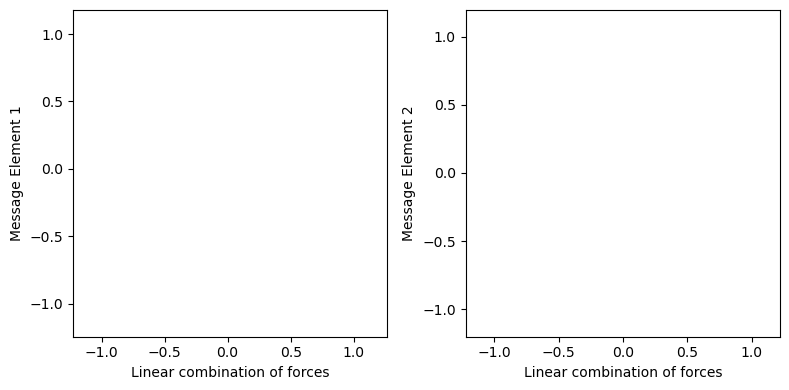

In [37]:

#Only turn on one of these:
plot_force_components = True
plot_sparsity = False
plot_rotation = False
if plot_force_components:
    fig, ax = plt.subplots(1, dim, figsize=(4*dim, 4))
if plot_sparsity or plot_rotation:
    fig, ax = plt.subplots(1, 1)
cam = Camera(fig)


last_alpha_x1 = 0.0
last_alpha_y1 = 0.0
t = lambda _: _#tqdm
for i in t(range(0, len(messages_over_time), 1)):
    msgs = copy(messages_over_time[i])

    msgs['bd'] = msgs.r + 1e-2

    try:
        msg_columns = ['e%d'%(k) for k in range(1, msg_dim+1)]
        msg_array = np.array(msgs[msg_columns])
    except:
        msg_columns = ['e%d'%(k) for k in range(msg_dim)]
        msg_array = np.array(msgs[msg_columns])

    msg_importance = msg_array.std(axis=0)
    most_important = np.argsort(msg_importance)[-dim:]
    msgs_to_compare = msg_array[:, most_important]
    msgs_to_compare = (msgs_to_compare - np.average(msgs_to_compare, axis=0)) / np.std(msgs_to_compare, axis=0)

    if plot_sparsity:
        ax.pcolormesh(msg_importance[np.argsort(msg_importance)[::-1][None, :15]], cmap='gray_r', edgecolors='k')
        # plt.colorbar()
        plt.axis('off')
        plt.grid(True)
        ax.set_aspect('equal')
        plt.text(15.5, 0.5, '...', fontsize=30)
        # fig.suptitle(title + test + 'mse=%.3e'%(min_result.fun/len(msgs),))
        plt.tight_layout()
    
    if plot_force_components or plot_rotation:
        pos_cols = ['dx', 'dy']
        if dim == 3:
            pos_cols.append('dz')

        if sim != 'spring':
            raise NotImplementedError("The current force function is for a spring. You will need to change the force function below to that expected by your simulation.")
        #force_fnc = lambda msg: -(msg.bd - 1)[:, None] * np.array(msg[pos_cols]) / msg.bd[:, None]
        force_fnc = lambda msg: -(msg['bd'].values - 1)[:, None] * np.array(msg[pos_cols].values) / msg['bd'].values[:, None] #OAC: New version of function above
        
        expected_forces = force_fnc(msgs)

        def percentile_sum(x):
            x = x.ravel()
            bot = x.min()
            top = np.percentile(x, 90)
            msk = (x>=bot) & (x<=top)
            frac_good = (msk).sum()/len(x)
            return x[msk].sum()/frac_good

        from scipy.optimize import minimize

        def linear_transformation_2d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
            lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

            score = (
                percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
                percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2))
            )/2.0

            return score

        def out_linear_transformation_2d(alpha):
            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1]) + alpha[2]
            lincomb2 = (alpha[3] * expected_forces[:, 0] + alpha[4] * expected_forces[:, 1]) + alpha[5]

            return lincomb1, lincomb2

        def linear_transformation_3d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
            lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
            lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

            score = (
                percentile_sum(np.square(msgs_to_compare[:, 0] - lincomb1)) +
                percentile_sum(np.square(msgs_to_compare[:, 1] - lincomb2)) +
                percentile_sum(np.square(msgs_to_compare[:, 2] - lincomb3))
            )/3.0

            return score

        def out_linear_transformation_3d(alpha):

            lincomb1 = (alpha[0] * expected_forces[:, 0] + alpha[1] * expected_forces[:, 1] + alpha[2] * expected_forces[:, 2]) + alpha[3]
            lincomb2 = (alpha[0+4] * expected_forces[:, 0] + alpha[1+4] * expected_forces[:, 1] + alpha[2+4] * expected_forces[:, 2]) + alpha[3+4]
            lincomb3 = (alpha[0+8] * expected_forces[:, 0] + alpha[1+8] * expected_forces[:, 1] + alpha[2+8] * expected_forces[:, 2]) + alpha[3+8]

            return lincomb1, lincomb2, lincomb3

        if dim == 2:
            min_result = minimize(linear_transformation_2d, np.ones(dim**2 + dim), method='Powell')
        if dim == 3:
            min_result = minimize(linear_transformation_3d, np.ones(dim**2 + dim), method='Powell')
        print(title, test, 'gets', min_result.fun/len(msgs))

        if plot_rotation:
            q = min_result.x
            alphax1, alphay1, offset1 = q[:3]
            alphax2, alphay2, offset2 = q[3:]
            
            s1 = alphax1**2 + alphay1**2
            s2 = alphax2**2 + alphay2**2
            
            if (
                    (alphax2 - last_alpha_x1)**2
                    + (alphay2 - last_alpha_y1)**2  <
                   (alphax1 - last_alpha_x1)**2
                    + (alphay1 - last_alpha_y1)**2):
                
                alphax1, alphay1, offset1 = q[3:]
                alphax2, alphay2, offset2 = q[:3]
                
            last_alpha_x1 = alphax1
            last_alpha_y1 = alphay1
            s1 = alphax1**2 + alphay1**2
            s2 = alphax2**2 + alphay2**2
            alphax1 /= s1**0.5 * 2
            alphay1 /= s1**0.5 * 2
            alphax2 /= s2**0.5 * 2
            alphay2 /= s2**0.5 * 2
            
            ax.arrow(0.5, 0.5, alphax1, alphay1, color='k', head_width=0.05, length_includes_head=True)
            ax.arrow(0.5, 0.5, alphax2, alphay2, color='k', head_width=0.05, length_includes_head=True)
            ax.axis('off')
        
        if plot_force_components:
            for i in range(dim):
                if dim == 3:
                    px = out_linear_transformation_3d(min_result.x)[i]
                else:
                    px = out_linear_transformation_2d(min_result.x)[i]

                py = msgs_to_compare[:, i]
                ax[i].scatter(px, py,
                              alpha=0.1, s=0.1, color='k')
                ax[i].set_xlabel('Linear combination of forces')
                ax[i].set_ylabel('Message Element %d'%(i+1))

                xlim = np.array([np.percentile(px, q) for q in [10, 90]])
                ylim = np.array([np.percentile(py, q) for q in [10, 90]])
                xlim[0], xlim[1] = xlim[0] - (xlim[1] - xlim[0])*0.05, xlim[1] + (xlim[1] - xlim[0])*0.05
                ylim[0], ylim[1] = ylim[0] - (ylim[1] - ylim[0])*0.05, ylim[1] + (ylim[1] - ylim[0])*0.05

                ax[i].set_xlim(xlim)
                ax[i].set_ylim(ylim)
                
        plt.tight_layout()
    
    cam.snap()

ani = cam.animate()
    
from IPython.display import HTML
HTML(ani.to_jshtml())

## Plot some predicted versus true trajectories:

In [38]:
from simulate import make_transparent_color

In [39]:
from scipy.integrate import odeint

/tmp/ipykernel_5125/3350896557.py:57: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


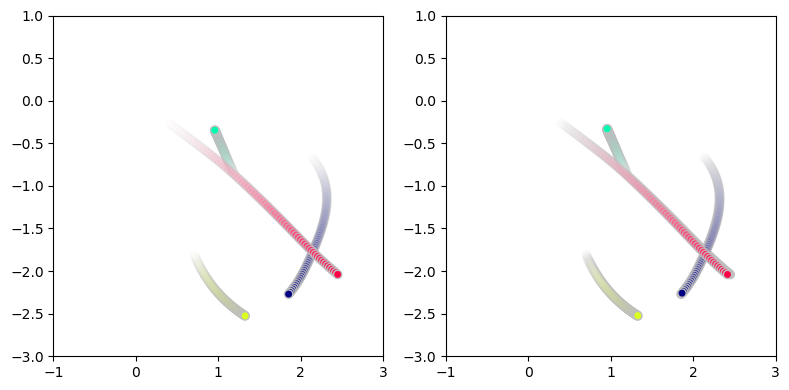

In [40]:
fig, ax = plt.subplots(1, 2, figsize=(8, 4))
camera = Camera(fig)

for current_model in [-1] + [1, 34, 67, 100, 133, 166, 199]:
    i = 4 #Use this simulation
    if current_model > len(recorded_models):
        continue

    #Truth:
    cutoff_time = 300
    times = onp.array(s.times)[:cutoff_time]
    x_times = onp.array(data[i, :cutoff_time])
    masses = x_times[:, :, -1]
    length_of_tail = 75

    #Learned:
    e = edge_index #.cuda()
    ogn.cpu()
    if current_model > -1:
        ogn.load_state_dict(recorded_models[current_model])
    else:
        # Random model!
        ogn = OGN(n_f, msg_dim, dim, dt=0.1, hidden=hidden, edge_index=get_edge_index(n, sim), aggr=aggr) #.cuda()
    ogn #.cuda()
    
    def odefunc(y, t=None):
        y = y.reshape(4, 6).astype(np.float32)
        cur = Data(
            x=torch.from_numpy(y), #.cuda(),
            edge_index=e
        )
        dx = y[:, 2:4]
        dv = ogn.just_derivative(cur).cpu().detach().numpy()
        dother = np.zeros_like(dx)
        return np.concatenate((dx, dv, dother), axis=1).ravel()

    datai = odeint(odefunc, (onp.asarray(x_times[0]).ravel()), times).reshape(-1, 4, 6)
    x_times2 = onp.array(datai)

    d_idx = 10
    for t_idx in range(d_idx, cutoff_time, d_idx):
        start = max([0, t_idx-length_of_tail])
        ctimes = times[start:t_idx]
        cx_times = x_times[start:t_idx]
        cx_times2 = x_times2[start:t_idx]
        for j in range(n):
            rgba = make_transparent_color(len(ctimes), j/n)
            ax[0].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=rgba)
            ax[1].scatter(cx_times2[:, j, 0], cx_times2[:, j, 1], color=rgba)
            black_rgba = rgba
            black_rgba[:, :3] = 0.75
            ax[1].scatter(cx_times[:, j, 0], cx_times[:, j, 1], color=black_rgba, zorder=-1)

        for k in range(2):
            ax[k].set_xlim(-1, 3)
            ax[k].set_ylim(-3, 1)
        plt.tight_layout()
        camera.snap()

# camera.animate().save('multiple_animations_with_comparison.mp4')
from IPython.display import HTML
HTML(camera.animate().to_jshtml())

# Symbolic regression

Extract the force laws with the following procedure:
- The data in `messages_over_time` correspond to inputs to, and features of, $\phi^e$, recorded during each training epoch.
- Select the last element of this list.
- Find the most significant message feature. Each message feature corresponds to 'e1', 'e2', etc. Calculate the one with the largest standard deviation.

Train [PySR](https://github.com/MilesCranmer/PySR) to fit this relationship.
Thus, we have extracted a force law from the graph network without priors on the functional form.

This is the same technique we used to extract the unknown dark matter overdensity equation from the Quijote simulations.


## Here's the best message, which we will study:

In [41]:
best_message = np.argmax([np.std(messages_over_time[-1]['e%d'%(i,)]) for i in range(100)])

## Here's a pandas dataframe of the message data:

In [42]:
nbody_df = messages_over_time[-1][['e%d'%(best_message,), 'dx', 'dy', 'r', 'm1', 'm2']]
nbody_df

,e75,dx,dy,r,m1,m2
0,-0.013930,0.543489,-0.778920,0.949788,5.785905,0.836671
1,-0.470903,1.947129,1.091559,2.232221,5.785905,0.770745
2,-0.019471,0.818097,-0.411026,0.915546,5.785905,0.800204
3,0.028521,-0.543489,0.778920,0.949788,0.836671,5.785905
4,-0.930712,1.403639,1.870479,2.338567,0.836671,0.770745
...,...,...,...,...,...,...
11995,-0.057122,0.491149,-0.143349,0.511641,0.163864,0.695851
11996,0.002730,0.882829,-0.116672,0.890506,0.163864,1.765544
11997,-0.511783,0.827249,1.477600,1.693411,1.765544,0.581951
11998,-0.082752,-0.391680,-0.026677,0.392587,1.765544,0.695851


## Now we just fit e4 as a function of dx, dy, r, m1, and m2, inside [PySR](https://github.com/MilesCranmer/PySR).

In [43]:
messages_over_time[-1][['dx', 'dy', 'r', 'm1', 'm2']].to_numpy

<bound method DataFrame.to_numpy of              dx        dy         r        m1        m2
0      0.543489 -0.778920  0.949788  5.785905  0.836671
1      1.947129  1.091559  2.232221  5.785905  0.770745
2      0.818097 -0.411026  0.915546  5.785905  0.800204
3     -0.543489  0.778920  0.949788  0.836671  5.785905
4      1.403639  1.870479  2.338567  0.836671  0.770745
...         ...       ...       ...       ...       ...
11995  0.491149 -0.143349  0.511641  0.163864  0.695851
11996  0.882829 -0.116672  0.890506  0.163864  1.765544
11997  0.827249  1.477600  1.693411  1.765544  0.581951
11998 -0.391680 -0.026677  0.392587  1.765544  0.695851
11999 -0.882829  0.116672  0.890506  1.765544  0.163864

[12000 rows x 5 columns]>

In [44]:
messages_over_time[-1][['e%d'%(best_message,)]].to_numpy

<bound method DataFrame.to_numpy of             e75
0     -0.013930
1     -0.470903
2     -0.019471
3      0.028521
4     -0.930712
...         ...
11995 -0.057122
11996  0.002730
11997 -0.511783
11998 -0.082752
11999  0.006562

[12000 rows x 1 columns]>

In [45]:
folder_path = '/home/omar/Documents/Code/symbolic_deep_learning' 
file_name = 'nbody_data.csv'

In [46]:
nbody_df.to_csv(f'{folder_path}/{file_name}', index=False)
print(f'DataFrame saved to {folder_path}/{file_name}')

DataFrame saved to /home/omar/Documents/Code/symbolic_deep_learning/nbody_data.csv
